In [1]:
%load_ext autoreload
%autoreload 2

import numpy as np
import rescomp

import matplotlib.pyplot as plt
import os

# new imports:
import rescomp.lyapunov_analysis as la

# Conduct experiment:
- compare divergence
- compare Largest LE qr
- compare divergence trajectory of qr algorithm

## Parameters used for divergence and LLE qr:

In [2]:
prepath = "C:/Users\Dennis\Documents\FILES&INFO\WISSEN\STUDIUM\Master LMU\Masterthesis\LyapunovExponentsSimulations"
exp_name_both = "KS_10_02"

In [3]:
# define all the simulations we want to test:

def create_ks_sim_func(mode, dimensions, system_size, *args):
    if mode == "precision":
        def data_creation_function(time_steps, dt, starting_point=None):
            return rescomp.simulations._kuramoto_sivashinsky_custom(dimensions, system_size, dt, time_steps, 
                                                                    starting_point,
                                     precision=args[1], fft_type=args[0])
    elif mode == "Bhatt":
        def data_creation_function(time_steps, dt, starting_point=None):
            return rescomp.simulations._kuramoto_sivashinsky_Bhatt(dimensions, system_size, dt, time_steps, 
                                                                   starting_point)
    elif mode == "normal":
        def data_creation_function(time_steps, dt, starting_point=None):
            return rescomp.simulations._kuramoto_sivashinsky(dimensions, system_size, dt, time_steps, starting_point)
    elif mode == "normal_M":
        def data_creation_function(time_steps, dt, starting_point=None):
            return rescomp.simulations._kuramoto_sivashinsky(dimensions, system_size, dt, time_steps, starting_point, 
                                                             M=args[0])
    elif mode == "rkstiff":
        def data_creation_function(time_steps, dt, starting_point=None):
            return rescomp.simulations._kuramoto_sivashinsky_rkstiff(dimensions, system_size, dt, time_steps, 
                                                                   starting_point, IF_eps=args[0])
    return data_creation_function

# Create different KS Sim functions:
def create_ks_sim_dict(dimensions, system_size):
    ks_sim_dict = {
                   "scipy32": create_ks_sim_func("precision", dimensions, system_size, "scipy", 32), 
                   "scipy64": create_ks_sim_func("precision", dimensions, system_size, "scipy", 64), 
                   "scipy": create_ks_sim_func("precision", dimensions, system_size, "scipy", None),
                   "numpy32": create_ks_sim_func("precision", dimensions, system_size, "numpy", 32),
                   "numpy64": create_ks_sim_func("precision", dimensions, system_size, "numpy", 64),
                   "numpy": create_ks_sim_func("precision", dimensions, system_size, "numpy", None),
                   "Bhatt": create_ks_sim_func("Bhatt", dimensions, system_size),
                   "normal": create_ks_sim_func("normal", dimensions, system_size),
                   "normalM1": create_ks_sim_func("normal", dimensions, system_size, 16),
                   "normalM2": create_ks_sim_func("normal", dimensions, system_size, 200),
                   "rkstiff": create_ks_sim_func("rkstiff", dimensions, system_size, 1e-4),
                   "rkstiffE1": create_ks_sim_func("rkstiff", dimensions, system_size, 1e-1), 
                   "rkstiffE2": create_ks_sim_func("rkstiff", dimensions, system_size, 1e-2), 
                   "rkstiffE3": create_ks_sim_func("rkstiff", dimensions, system_size, 1e-7), 
    }
    return ks_sim_dict

In [5]:
# create the "create_sim_func" func:
def create_sim_func(parameters):
    dims = parameters["dims"]
    L = parameters["L"]
    sim = parameters["sim"]
    return create_ks_sim_dict(dimensions=dims, system_size=L)[sim]

# create the "create_sp_func" starting point func:
def create_sp_func(parameters, Nens):
    mode = parameters["mode"]
    dims = parameters["dims"]
    seed = parameters["seed"]
    L = parameters["L"]

    # default params
    if "noise" in parameters.keys():
        noise = parameters["noise"]
    else:
        noise = 0.1
    np.random.seed(seed)
    if mode == "default":
        x = L * np.transpose(np.conj(np.arange(1, dims + 1))) / dims
        base = np.cos(2 * np.pi * x / L) * (1 + np.sin(2 * np.pi * x / L))
        starting_points = np.repeat(base[np.newaxis, :], Nens, axis=0)
        starting_points += np.random.randn(Nens, dims)*noise
    elif mode == "random":
        starting_points = np.random.randn(Nens, dims)
    return starting_points

create_sp_func_keys = ["dims", "seed", "L", "mode"]

create_sim_func_keys = ["dims", "L", "sim"]

## Exp1: Compare Divergence:

In [40]:
# create the parameter dict to define the experiment:
parameter_dict = {
    "L": [12, 13.5, 22, 36, 60, 100],
    # "L": [13.5],
    "dims": [150],
    "sim": ["scipy", "scipy32", "scipy64", ], # , "Bhatt", "Pathak", "rkstiffE1", "numpy", "numpy32", "numpy64",
    "seed": 100,
    "mode": ["random"],
    
    "dt": [0.25],
    "tau": [100],
    "T": 30,
    
    "eps":  [1e-6]
}
# define Ndims and Nens
Ndims = 20
Nens = 50

# define saving:
save = True

div_name = "_div_L"
exp_name_div = exp_name_both + div_name

# other parameters:
get_info = True
random_directions = True

out_div = la.compare_simulations_div(create_sim_func, create_sp_func, create_sim_func_keys, create_sp_func_keys,
                    parameter_dict, save=save, prepath=prepath, exp_name=exp_name_div, Nens=Nens, Ndims=Ndims
                         , get_info=get_info, random_directions=random_directions)

--------------------
create_sim_func_keys ['dims', 'L', 'sim']
create_sp_func_keys ['dims', 'seed', 'L', 'mode']
--------------------
--------------------
PARAMETERS: 
L [12, 13.5, 22, 36, 60, 100]
dims 150
sim ['scipy', 'scipy32', 'scipy64']
seed 100
mode random
dt 0.25
tau 100
T 30
eps 1e-06
--------------------
STARTING CALCULATIONS (18): 
simulate the tau time steps ...
....
CALC: 1/18
{'L': 12, 'dims': 150, 'sim': 'scipy', 'seed': 100, 'mode': 'random'}, dt: 0.25, tau: 100, T: 30, eps: 1e-06
N_ens: 1/50
timestep 120/120
N_ens: 2/50
timestep 120/120
N_ens: 3/50
timestep 120/120
N_ens: 4/50
timestep 120/120
N_ens: 5/50
timestep 120/120
N_ens: 6/50
timestep 120/120
N_ens: 7/50
timestep 120/120
N_ens: 8/50
timestep 120/120
N_ens: 9/50
timestep 120/120
N_ens: 10/50
timestep 120/120
N_ens: 11/50
timestep 120/120
N_ens: 12/50
timestep 120/120
N_ens: 13/50
timestep 120/120
N_ens: 14/50
timestep 120/120
N_ens: 15/50
timestep 120/120
N_ens: 16/50
timestep 120/120
N_ens: 17/50
timestep 120/1

## Exp2: LLE qr and trajectory divergence:

In [6]:
# create the parameter dict to define the experiment:
parameter_dict = {
    "L": [12, 13.5, 22, 36, 60, 100],
    # "L": [13.5],
    "dims": [150],
    "sim": ["scipy", "scipy32", "scipy64", ],
    # "sim": ["normal", "Bhatt", "Pathak", "rkstiffE1", "numpy", "numpy32", "numpy64"],
    "seed": 100,
    "mode": ["random"],
    
    "dt": [0.25],
    "tau": 100,
    "T": [2, 5, 10],
    
    "eps": [1e-6], 
    "Nqr": 100,
}

# define Nle and Nens
Nle = 1
Nens = 50

# return trajectory div:
traj_div=True

# define saving:
save = True
qr_name = "_qr_L"
exp_name_qr = exp_name_both + qr_name

# other parameters:
get_info = True

out_qr = la.compare_simulations_leqr(create_sim_func, create_sp_func, create_sim_func_keys, create_sp_func_keys,
                    parameter_dict, save=save, prepath=prepath, exp_name=exp_name_qr, Nens=Nens, Nle=Nle
                    , get_info=get_info, traj_div=True)

--------------------
create_sim_func_keys ['dims', 'L', 'sim']
create_sp_func_keys ['dims', 'seed', 'L', 'mode']
--------------------
--------------------
PARAMETERS: 
L [12, 13.5, 22, 36, 60, 100]
dims 150
sim ['scipy', 'scipy32', 'scipy64']
seed 100
mode random
dt 0.25
tau 100
T [2, 5, 10]
eps 1e-06
Nqr 100
--------------------
STARTING CALCULATIONS (54): 
....
CALC: 1/54
{'L': 12, 'dims': 150, 'sim': 'scipy', 'seed': 100, 'mode': 'random'}, dt: 0.25, tau: 100, T: 2, eps: 1e-06, Nqr: 100
N_ens: 1/50
N_ens: 2/50
N_ens: 3/50
N_ens: 4/50
N_ens: 5/50
N_ens: 6/50
N_ens: 7/50
N_ens: 8/50
N_ens: 9/50
N_ens: 10/50
N_ens: 11/50
N_ens: 12/50
N_ens: 13/50
N_ens: 14/50
N_ens: 15/50
N_ens: 16/50
N_ens: 17/50
N_ens: 18/50
N_ens: 19/50
N_ens: 20/50
N_ens: 21/50
N_ens: 22/50
N_ens: 23/50
N_ens: 24/50
N_ens: 25/50
N_ens: 26/50
N_ens: 27/50
N_ens: 28/50
N_ens: 29/50
N_ens: 30/50
N_ens: 31/50
N_ens: 32/50
N_ens: 33/50
N_ens: 34/50
N_ens: 35/50
N_ens: 36/50
N_ens: 37/50
N_ens: 38/50
N_ens: 39/50
N_ens: 

C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\measures.py:625: RuntimeWarning: divide by zero encountered in log
  lyapunov_exp = np.sum(np.log(np.abs(R_diags))/(N*T), axis = 0)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\measures.py:631: RuntimeWarning: divide by zero encountered in log
  lyapunov_exp_convergence = np.cumsum(np.log(np.abs(R_diags)), axis = 0)/(np.tile(times, (m, 1)).T)


N_ens: 11/50
N_ens: 12/50
N_ens: 13/50
N_ens: 14/50
N_ens: 15/50
N_ens: 16/50
N_ens: 17/50
N_ens: 18/50
N_ens: 19/50
N_ens: 20/50
N_ens: 21/50
N_ens: 22/50
N_ens: 23/50
N_ens: 24/50
N_ens: 25/50
N_ens: 26/50
N_ens: 27/50
N_ens: 28/50
N_ens: 29/50
N_ens: 30/50
N_ens: 31/50
N_ens: 32/50
N_ens: 33/50
N_ens: 34/50
N_ens: 35/50
N_ens: 36/50
N_ens: 37/50
N_ens: 38/50
N_ens: 39/50
N_ens: 40/50
N_ens: 41/50
N_ens: 42/50
N_ens: 43/50
N_ens: 44/50
N_ens: 45/50
N_ens: 46/50
N_ens: 47/50
N_ens: 48/50
N_ens: 49/50
N_ens: 50/50
....
CALC: 5/54
{'L': 12, 'dims': 150, 'sim': 'scipy32', 'seed': 100, 'mode': 'random'}, dt: 0.25, tau: 100, T: 5, eps: 1e-06, Nqr: 100
N_ens: 1/50
N_ens: 2/50
N_ens: 3/50
N_ens: 4/50
N_ens: 5/50
N_ens: 6/50
N_ens: 7/50
N_ens: 8/50
N_ens: 9/50
N_ens: 10/50
N_ens: 11/50
N_ens: 12/50
N_ens: 13/50
N_ens: 14/50
N_ens: 15/50
N_ens: 16/50
N_ens: 17/50
N_ens: 18/50
N_ens: 19/50
N_ens: 20/50
N_ens: 21/50
N_ens: 22/50
N_ens: 23/50
N_ens: 24/50
N_ens: 25/50
N_ens: 26/50
N_ens: 27/50
N_

# Plotting:

### Plot trajectories:

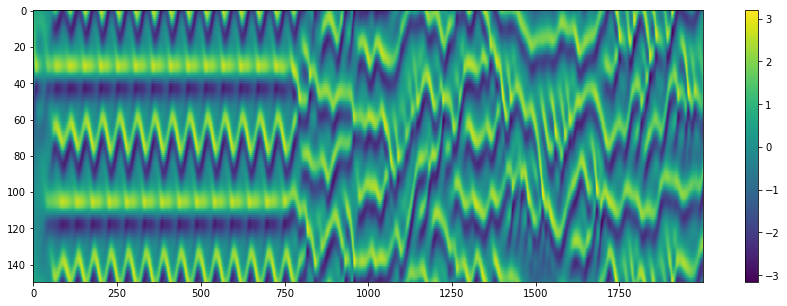

In [70]:
parameters = {
    "sim": "scipy",
    "L": 35.3,
    "dims": 150,
    "mode": "default", # "random"
    "seed": 100,
    "noise": 0,
}
Nens = 1

sim_func = create_sim_func(parameters)
starting_points = create_sp_func(parameters, Nens)

i = 0
starting_point = starting_points[i, :]

dt = 0.5
T = 1000
time_steps = int(T/dt)
traj = sim_func(time_steps, dt, starting_point)

plt.figure(figsize=(15,5))
plt.imshow(traj.T, aspect="auto")
plt.colorbar()

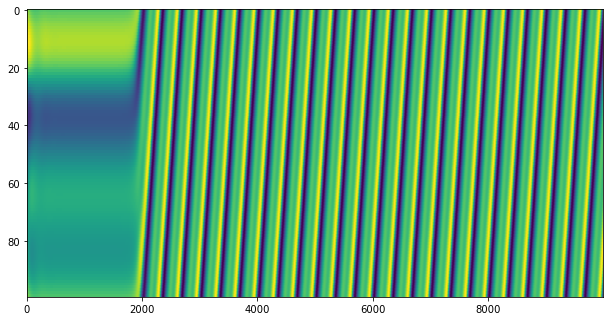

In [122]:
import matplotlib.animation as ani

fig, ax = plt.subplots(figsize=(8, 4))



def animate(i, Ls):
    ax.clear()
    L = Ls[i]

    parameters = {
    "sim": "scipy",
    "L": L,
    "dims": 100,
    "mode": "default", # "random"
    "seed": 100,
    "noise": 0,
    }
    Nens = 1

    sim_func = create_sim_func(parameters)
    starting_points = create_sp_func(parameters, Nens)

    i = 0
    starting_point = starting_points[i, :]

    dt = 0.1
    T = 1000
    time_steps = int(T/dt)
    traj = sim_func(time_steps, dt, starting_point)
    ax.imshow(traj.T, aspect="auto")

# remove axis and whitespace:
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)

Ls = np.arange(12, 45, 0.05)
animator = ani.FuncAnimation(fig, animate, frames=len(Ls), fargs=(Ls, ), interval = 100)
plt.show()

In [123]:
animator.save("movie.mp4")

In [96]:
writergif = ani.PillowWriter(fps=30)
animator.save("test.gif", writer=writergif)

### Plot results div:

In [12]:
#### if you want to LOAD results:
div_name = "_div_L"
exp_name_div = exp_name_both + div_name
#### 

la.load_info_file(prepath, exp_name_div)

{'Ndims': 20,
 'Nens': 50,
 'date': '10/02/2022',
 'exp_name': 'KS_10_02_div_L',
 'parameter_dict': {'L': [12, 13.5, 22, 36, 60, 100],
  'T': [30],
  'dims': [150],
  'dt': [0.25],
  'eps': [1e-06],
  'mode': ['random'],
  'seed': [100],
  'sim': ['scipy', 'scipy32', 'scipy64'],
  'tau': [100]},
 'prefix': 'div',
 'time[min]': '144.218'}

lines: 3, cols: 6, rows: 1


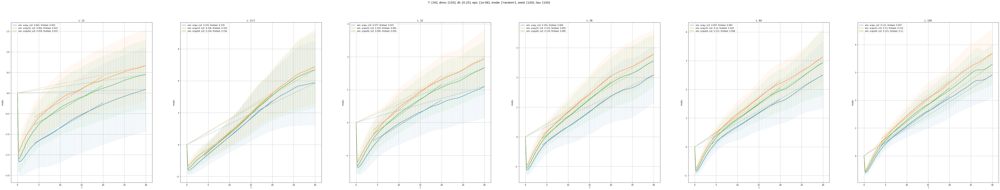

In [15]:
plot_func = la.plot_div_file

zs = ["sim"]
xs = ["L"]
ys = []

# la.plot_div_file kwargs
mean_axs = "all"
show_error = 1
dim_index = None
ens_index = None

include_fit = 1
t_min = 4
t_max = 20

include_fit_qr = 1
t_min_qr = 0
t_max_qr = 30

subfigsize = (15, 15)
xlims = None # (0,10)
ylims = None # (-1, 10)

la.plot_experiment(plot_func, prepath, exp_name_div, zs=zs, xs=xs, ys=ys, subfigsize=subfigsize, xlims=xlims,
                     ylims=ylims,
                     mean_axs=mean_axs, show_error=show_error,
                 rel_dist=True, include_fit=include_fit, dim_index=dim_index, ens_index=ens_index, 
                t_min=t_min, t_max=t_max, include_fit_qr=include_fit_qr, t_min_qr=t_min_qr, t_max_qr=t_max_qr)

### Plot results qr:

In [ ]:
#### if you want to LOAD results:
qr_name = "_qr3"
exp_name_qr = exp_name_both + qr_name
#### 

la.load_info_file(prepath, exp_name_qr)

lines: 3, cols: 3, rows: 6
latest LEs: [0.013]
latest LEs: [-inf]
latest LEs: [-inf]
latest LEs: [0.024]
latest LEs: [-inf]
latest LEs: [-inf]
latest LEs: [0.048]
latest LEs: [0.638]
latest LEs: [0.488]
latest LEs: [0.075]
latest LEs: [0.754]
latest LEs: [0.605]
latest LEs: [0.084]
latest LEs: [0.832]
latest LEs: [0.684]
latest LEs: [0.087]
latest LEs: [0.922]
latest LEs: [0.772]
latest LEs: [0.007]
latest LEs: [-inf]
latest LEs: [-inf]
latest LEs: [0.01]
latest LEs: [-inf]
latest LEs: [-inf]
latest LEs: [0.05]
latest LEs: [0.38]
latest LEs: [0.326]
latest LEs: [0.075]
latest LEs: [0.447]
latest LEs: [0.391]
latest LEs: [0.085]
latest LEs: [0.489]
latest LEs: [0.429]
latest LEs: [0.09]
latest LEs: [0.53]
latest LEs: [0.469]
latest LEs: [0.004]
latest LEs: [-inf]
latest LEs: [-inf]
latest LEs: [0.005]
latest LEs: [0.3]
latest LEs: [-inf]
latest LEs: [0.049]
latest LEs: [0.265]
latest LEs: [0.235]
latest LEs: [0.076]
latest LEs: [0.304]
latest LEs: [0.274]
latest LEs: [0.086]
latest LEs:

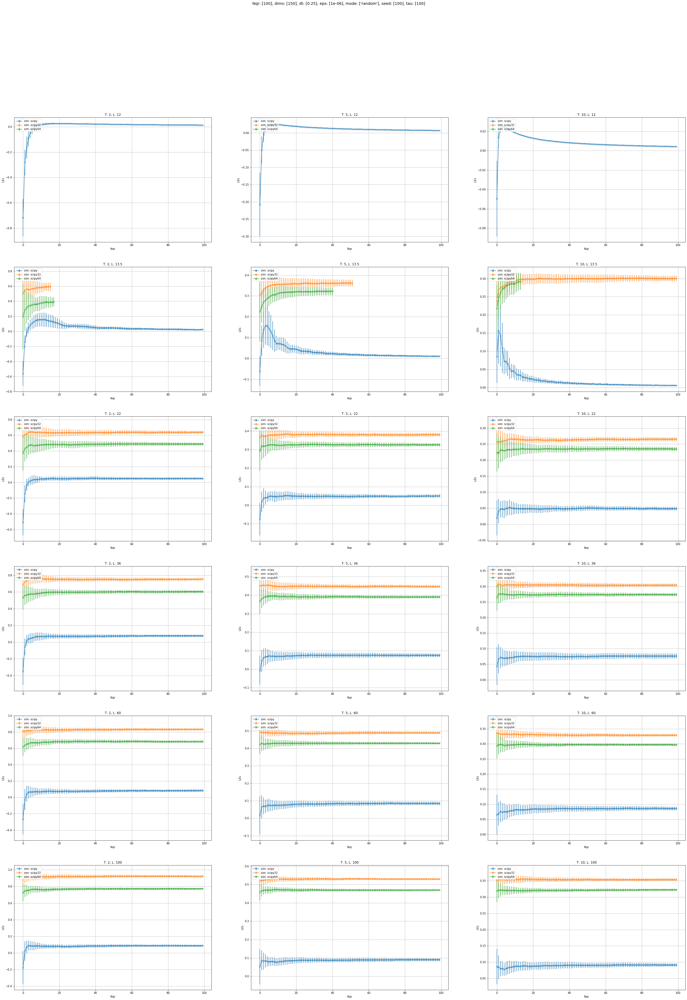

In [10]:
plot_func = la.plot_leqr_file

zs = ["sim"]
xs = ["T"]
ys = ["L"]

# la.plot_leqr_file kwargs
mean_axs = "ens"
show_error = True
le_index = None
ens_index = None
every_x_tick = False
subfigsize= (15, 10)

prefix="leqr"

# ylims=(0.05, 0.1)
ylims = None

subfigsize = (15, 10)
la.plot_experiment(plot_func, prepath, exp_name_qr, prefix=prefix, zs=zs, xs=xs, ys=ys, subfigsize=subfigsize, mean_axs=mean_axs, show_error=show_error, ylims=ylims,
                 le_index=le_index, ens_index=ens_index, every_x_tick=every_x_tick,
                )

### Plot results qr trajectory divergence

lines: 1, cols: 3, rows: 18


No handles with labels found to put in legend.


mean sloap: 0.013


No handles with labels found to put in legend.


mean sloap: 0.024


No handles with labels found to put in legend.


mean sloap: 0.048


No handles with labels found to put in legend.


mean sloap: 0.075


No handles with labels found to put in legend.


mean sloap: 0.084


No handles with labels found to put in legend.


mean sloap: 0.087


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:540: RuntimeWarning: divide by zero encountered in log
  array = np.log(array)
C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users

mean sloap: -inf


C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
No handles with labels found to put in legend.


mean sloap: -inf


No handles with labels found to put in legend.


mean sloap: 0.638


No handles with labels found to put in legend.


mean sloap: 0.754


No handles with labels found to put in legend.


mean sloap: 0.832


No handles with labels found to put in legend.


mean sloap: 0.922


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:540: RuntimeWarning: divide by zero encountered in log
  array = np.log(array)
C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users

mean sloap: -inf


C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
No handles with labels found to put in legend.


mean sloap: -inf


No handles with labels found to put in legend.


mean sloap: 0.488


No handles with labels found to put in legend.


mean sloap: 0.605


No handles with labels found to put in legend.


mean sloap: 0.684


No handles with labels found to put in legend.


mean sloap: 0.772


No handles with labels found to put in legend.


mean sloap: 0.007


No handles with labels found to put in legend.


mean sloap: 0.01


No handles with labels found to put in legend.


mean sloap: 0.05


No handles with labels found to put in legend.


mean sloap: 0.075


No handles with labels found to put in legend.


mean sloap: 0.085


No handles with labels found to put in legend.


mean sloap: 0.09


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:540: RuntimeWarning: divide by zero encountered in log
  array = np.log(array)
C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
No handl

mean sloap: -inf


C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
No handles with labels found to put in legend.


mean sloap: -inf


No handles with labels found to put in legend.


mean sloap: 0.38


No handles with labels found to put in legend.


mean sloap: 0.447


No handles with labels found to put in legend.


mean sloap: 0.489


No handles with labels found to put in legend.


mean sloap: 0.53


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:540: RuntimeWarning: divide by zero encountered in log
  array = np.log(array)
C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users

mean sloap: -inf


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
No handles with labels found to put in legend.


mean sloap: -inf


No handles with labels found to put in legend.


mean sloap: 0.326


No handles with labels found to put in legend.


mean sloap: 0.391


No handles with labels found to put in legend.


mean sloap: 0.429


No handles with labels found to put in legend.


mean sloap: 0.469


No handles with labels found to put in legend.


mean sloap: 0.004


No handles with labels found to put in legend.


mean sloap: 0.005


No handles with labels found to put in legend.


mean sloap: 0.049


No handles with labels found to put in legend.


mean sloap: 0.076


No handles with labels found to put in legend.


mean sloap: 0.086


No handles with labels found to put in legend.


mean sloap: 0.091


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:540: RuntimeWarning: divide by zero encountered in log
  array = np.log(array)
C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users

mean sloap: -inf


No handles with labels found to put in legend.


mean sloap: 0.3


No handles with labels found to put in legend.


mean sloap: 0.265


No handles with labels found to put in legend.


mean sloap: 0.304


No handles with labels found to put in legend.


mean sloap: 0.328


No handles with labels found to put in legend.


mean sloap: 0.354


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:540: RuntimeWarning: divide by zero encountered in log
  array = np.log(array)
C:\Users\Dennis\anaconda3\envs\rc_env_np16p6\lib\site-packages\numpy\core\_methods.py:117: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users

mean sloap: -inf


C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
C:\Users\Dennis\Documents\GitHub\rescomp\rescomp\lyapunov_analysis.py:591: RuntimeWarning: invalid value encountered in subtract
  p = ax.errorbar(x=x_current, y=data, yerr=(data_error_high - data, data - data_error_low),
No handles with labels found to put in legend.


mean sloap: -inf


No handles with labels found to put in legend.


mean sloap: 0.235


No handles with labels found to put in legend.


mean sloap: 0.274


No handles with labels found to put in legend.


mean sloap: 0.297


No handles with labels found to put in legend.


mean sloap: 0.322


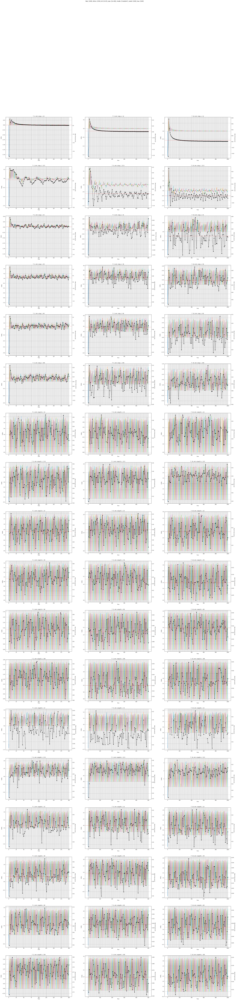

In [14]:
plot_func = la.plot_qrdiv_file

zs = []
xs = ["T"]
ys = ["sim", "L"]

# la.plot_leqr_file kwargs
mean_axs = "ens"
show_error = False
le_index = None
ens_index = None

rel_dist=True
include_fit_qr=True

subfigsize = (15, 10)
prefix="qrdiv"
la.plot_experiment(plot_func, prepath, exp_name_qr, prefix=prefix,  zs=zs, xs=xs, ys=ys,
                     subfigsize=subfigsize, mean_axs=mean_axs, show_error=show_error,
                 le_index=le_index, ens_index=ens_index, rel_dist=rel_dist, include_fit_qr=include_fit_qr
                )